# 3. Fitting diads once you have groups
- Once you have divided your diads into groups based on strengths, you need to tweak the fit parameters for each group
- Then you can loop through all files in a given group and automatically fit the spectra

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import joblib
import DiadFit as pf
pf.__version__

'0.0.88'

## Specifying filetype, and folder as before

In [2]:
# This specifies what file type your Raman exported in. 
meta_path, spectra_path, spectra_filetype, prefix, str_prefix, spectra_file_ext, meta_file_ext, TruPower=pf.get_settings()

## Load in data and fit parameters
- This loads in the dataframes of the fit parameters you saved in the other file, by group
- At this point you select what group you want to fit (batch = 'Weak', 'Medium' or 'Strong'). After running through the entire notebook for one group, come back up here to fit a second group.

In [3]:
## load dataframes and numpy arrays 
np_x = joblib.load('np_x.sav')

# Select the group you want to fit ('Weak', 'Medium', 'Strong'). After selecting one, go through and select another one and run again from here. 
batch='Weak' # Options are Weak, Medium, Strong

if batch=='Weak':
    GroupN_df=joblib.load('Weak_df.sav')
if batch=='Medium':
    GroupN_df=joblib.load('Medium_df.sav')
if batch=='Strong':
    GroupN_df=joblib.load('Strong_df.sav')

### Now load one file from this group to tweak parameters for

In [4]:
Diad_Files =GroupN_df['filename']
i=0


### Lets plot the diad to have a look at it

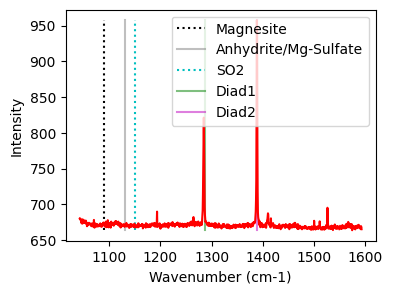

In [5]:
plot1=pf.plot_diad(path=spectra_path, filename=Diad_Files[i], filetype=spectra_filetype)

## Now lets inspect the diads and get their approximate positions
- As with generic peak, you can exclude 2 segments (e.g. around cosmic rays)
- You then specify how many peaks you want to fit on each diad. 1 means just the strong peak, 2 hotbands, and 3 for Diad2 would also fit the C13 peak if present. 
- The identify_diad_peaks then uses scipy findpeaks to identify the positions of the 2 diads, and any other peaks the user asks for. These are saved, and fed into the later functions for peak fitting. 

## Choose a model for fitting all peaks
- Option of Voigt or PseudoVoigt. We recomend PsuedoVoigt

In [6]:
model_name='PseudoVoigtModel'

## Fit Diad 1
- Tweak the parameters in the config files for each group. E.g. how many peaks (fit_peaks), the background positions, the sigma of the diad, and whether or not you want a gaussian background

In [7]:
diad_id_config=pf.diad_id_config(height=50, exclude_range1=[1308, 1309])
diad_id_config

if batch=='Weak':
    diad1_fit_config_init=pf.diad1_fit_config(
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1250),
    upper_bck_diad1=(1300, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=100, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
    diad1_fit_config_init

if batch=='Medium':
    diad1_fit_config_init=pf.diad1_fit_config(
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=2, lower_bck_diad1=(1180, 1240),
    upper_bck_diad1=(1315, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=100, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
    diad1_fit_config_init

if batch=='Strong':
    diad1_fit_config_init=pf.diad1_fit_config(
    fit_gauss=True, gauss_amp= 2*GroupN_df['HB1_abs_prom'].iloc[i],
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1220),
    upper_bck_diad1=(1330, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=1000, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
diad1_fit_config_init

diad1_fit_config(model_name='PseudoVoigtModel', fit_peaks=2, N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1250), upper_bck_diad1=(1300, 1350), fit_gauss=False, gauss_amp=1000, diad_sigma=0.6, diad_sigma_min_allowance=0.2, diad_sigma_max_allowance=5, diad_prom=152.18750965313734, HB_prom=nan, x_range_baseline=30, y_range_baseline=100, dpi=200, x_range_residual=10, return_other_params=False)

### See what these fit parameters look like for diad1

,Diad1_Combofit_Cent,Diad1_Voigt_Cent,Diad1_cent_err,Diad1_Voigt_Area,Diad1_Voigt_Sigma,Diad1_Voigt_Gamma,Diad1_Combofit_Height,Diad1_Residual,Diad1_Prop_Lor,Diad1_fwhm,Diad1_refit,Diad1_Asym50,Diad1_Asym70,Diad1_Yuan2017_sym_factor,Diad1_Remigi2021_BSF,Diad1_PDF_Model
0,1284.397846,1284.397846,0.012613,411.388964,0.991986,0,151.608468,2.190165,0.687831,1.983973,Flagged Warnings:,1.168831,1.206077,0.334956,0.013086,PseudoVoigtModel


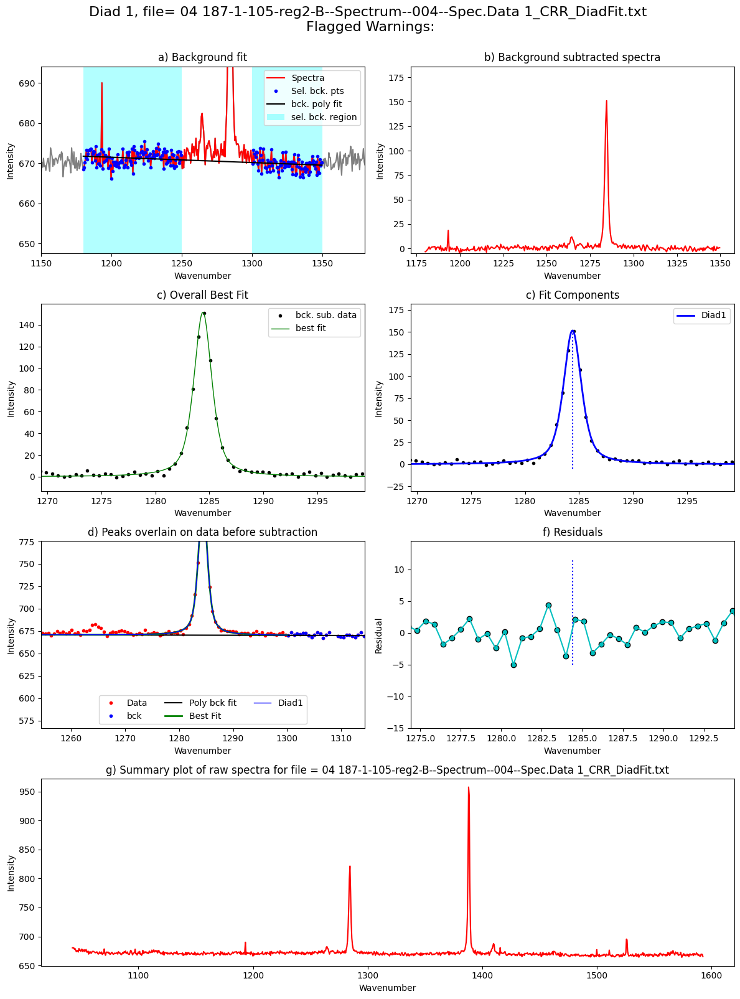

In [8]:
Diad1_fit=pf.fit_diad_1_w_bck(config1=diad1_fit_config_init,
config2=diad_id_config,
path=spectra_path, filename=Diad_Files.iloc[0],
filetype=spectra_filetype, plot_figure=True, close_figure=False,
Diad_pos=GroupN_df['Diad1_pos'].iloc[i],
HB_pos=GroupN_df['HB1_pos'].iloc[i])
Diad1_fit

### Update the sigma
- The sigma parameter varies quite a lot based on the splitting. Best to update your first guess with what you found for the example file above

In [9]:
diad1_fit_config2=diad1_fit_config_init

## Fit diad2

In [10]:
if batch=='Weak':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=2, upper_bck_diad2=(1430, 1480),
    lower_bck_diad2=(1310, 1360), diad_sigma=0.4,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=100,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i])
    diad2_fit_config_init

if batch=='Medium':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=3, fit_gauss=True, gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i],
    lower_bck_diad2=(1310, 1350), diad_sigma=1,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=100,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i],
    C13_prom=GroupN_df['C13_abs_prom'].iloc[i])
    diad2_fit_config_init

if batch=='Strong':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=3, fit_gauss=True, gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i],
    lower_bck_diad2=(1310, 1340), diad_sigma=1,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=1000,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i],
    C13_prom=GroupN_df['C13_abs_prom'].iloc[i])
    diad2_fit_config_init
diad2_fit_config_init

diad2_fit_config(model_name='PseudoVoigtModel', fit_peaks=2, N_poly_bck_diad2=2, lower_bck_diad2=(1310, 1360), upper_bck_diad2=(1430, 1480), fit_gauss=False, gauss_amp=1000, diad_sigma=0.4, diad_sigma_min_allowance=0.2, diad_sigma_max_allowance=5, diad_prom=305.84379922009066, HB_prom=nan, C13_prom=10, x_range_baseline=30, y_range_baseline=100, plot_figure=True, dpi=200, x_range_residual=30, return_other_params=False)

### See what these fit parameters look like for diad2

,Diad2_Combofit_Cent,Diad2_Voigt_Cent,Diad2_cent_err,Diad2_Voigt_Area,Diad2_Voigt_Sigma,Diad2_Voigt_Gamma,Diad2_Combofit_Height,Diad2_Residual,Diad2_Prop_Lor,Diad2_fwhm,Diad2_refit,Diad2_Asym50,Diad2_Asym70,Diad2_Yuan2017_sym_factor,Diad2_Remigi2021_BSF,Diad2_PDF_Model
0,1388.240132,1388.240132,0.005547,628.137071,0.729565,0,314.280865,2.251481,0.691435,1.459131,Flagged Warnings:,1.067442,1.087179,0.098406,0.004643,PseudoVoigtModel


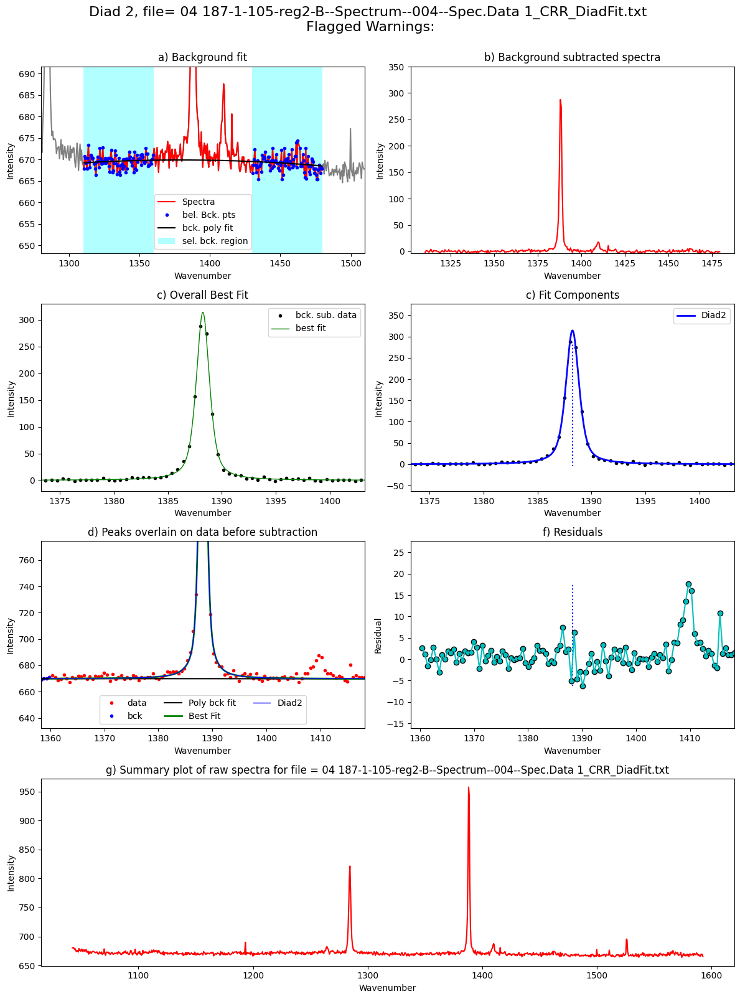

In [11]:
Diad2_fit=pf.fit_diad_2_w_bck(config1=diad2_fit_config_init,
    config2=diad_id_config,
path=spectra_path, filename=Diad_Files[i], filetype=spectra_filetype,
plot_figure=True, close_figure=False, 
Diad_pos=GroupN_df['Diad2_pos'].iloc[i],
HB_pos=GroupN_df['HB2_pos'].iloc[i], 
C13_pos=GroupN_df['C13_pos'].iloc[i])
Diad2_fit.to_clipboard(excel=True)
Diad2_fit

## Loop over all the files in the group
- This will loop over all the 

  0%|          | 0/67 [00:00<?, ?it/s]

Processing file: 04 187-1-105-reg2-B--Spectrum--004--Spec.Data 1_CRR_DiadFit.txt


  1%|▏         | 1/67 [00:02<02:46,  2.52s/it]

Processing file: 05 187-1-105-reg2-B--Spectrum--005--Spec.Data 1_CRR_DiadFit.txt


  3%|▎         | 2/67 [00:04<02:32,  2.34s/it]

Processing file: 06 187-1-105-reg2-B--Spectrum--006--Spec.Data 1_CRR_DiadFit.txt


  4%|▍         | 3/67 [00:07<02:30,  2.36s/it]

Processing file: 07 187-1-105-reg3-A--Spectrum--012--Spec.Data 1_CRR_DiadFit.txt


  6%|▌         | 4/67 [00:09<02:28,  2.35s/it]

Processing file: 09 187-1-105-reg3-A--Spectrum--016--Spec.Data 1.txt


  7%|▋         | 5/67 [00:11<02:22,  2.30s/it]

Processing file: 10 187-1-105-reg3-A--Spectrum--017--Spec.Data 1.txt


  9%|▉         | 6/67 [00:14<02:22,  2.33s/it]

Processing file: 12 187-1-105-reg3-B--Spectrum--021--Spec.Data 1.txt


 10%|█         | 7/67 [00:16<02:17,  2.29s/it]

Processing file: 13 187-1-105-reg3-B--Spectrum--022--Spec.Data 1.txt


 12%|█▏        | 8/67 [00:18<02:15,  2.29s/it]

Processing file: 14 187-1-105-reg3-B--Spectrum--023--Spec.Data 1_CRR_DiadFit.txt


 13%|█▎        | 9/67 [00:20<02:13,  2.30s/it]

Processing file: 16 187-1-105-reg3-C--Spectrum--027--Spec.Data 1.txt


 15%|█▍        | 10/67 [00:23<02:11,  2.30s/it]c:\users\charl\documents\python dev\diadfit\src\DiadFit\diads.py:3104: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,axes=plt.subplot_mosaic(mosaic=figure_mosaic, figsize=(12, 16))


Processing file: 17 187-1-105-reg3-C--Spectrum--028--Spec.Data 1.txt


 16%|█▋        | 11/67 [00:25<02:07,  2.28s/it]

Processing file: 18 187-1-105-reg3-C--Spectrum--029--Spec.Data 1.txt


 18%|█▊        | 12/67 [00:27<02:02,  2.24s/it]

Processing file: 21 187-1-105-reg4-A--Spectrum--042--Spec.Data 1.txt


 19%|█▉        | 13/67 [00:29<02:02,  2.27s/it]

Processing file: 23 187-1-105-reg4-A--Spectrum--044--Spec.Data 1.txt


 21%|██        | 14/67 [00:32<02:08,  2.43s/it]

Processing file: 24 187-1-105-reg4-A--Spectrum--045--Spec.Data 1.txt


 22%|██▏       | 15/67 [00:35<02:05,  2.41s/it]

Processing file: 26 187-1-105-reg4-B--Spectrum--049--Spec.Data 1.txt


 24%|██▍       | 16/67 [00:37<02:02,  2.41s/it]

Processing file: 27 187-1-105-reg4-B--Spectrum--050--Spec.Data 1_CRR_DiadFit.txt


 25%|██▌       | 17/67 [00:39<01:53,  2.28s/it]

Processing file: 28 187-1-105-reg4-B--Spectrum--051--Spec.Data 1_CRR_DiadFit.txt


 27%|██▋       | 18/67 [00:41<01:50,  2.26s/it]

Processing file: 29 test--Spectrum--052--Spec.Data 1.txt
below your threshold intensity, we have filled with nans


 28%|██▊       | 19/67 [00:43<01:43,  2.16s/it]

Processing file: 30 test--Spectrum--053--Spec.Data 1.txt


 30%|██▉       | 20/67 [00:45<01:39,  2.12s/it]

Processing file: 31 test--Spectrum--054--Spec.Data 1.txt


 31%|███▏      | 21/67 [00:47<01:36,  2.09s/it]

Processing file: 32 test--Spectrum--055--Spec.Data 1.txt


 33%|███▎      | 22/67 [00:49<01:31,  2.04s/it]

Processing file: 33 test--Spectrum--056--Spec.Data 1.txt


 34%|███▍      | 23/67 [00:51<01:32,  2.11s/it]

Processing file: 34 test--Spectrum--057--Spec.Data 1.txt


 36%|███▌      | 24/67 [00:53<01:29,  2.08s/it]

Processing file: 36 187-1-105-reg4-C--Spectrum--061--Spec.Data 1.txt


 37%|███▋      | 25/67 [00:55<01:26,  2.07s/it]

Processing file: 37 187-1-105-reg4-C--Spectrum--062--Spec.Data 1.txt


 39%|███▉      | 26/67 [00:57<01:25,  2.08s/it]

Processing file: 38 187-1-105-reg4-C--Spectrum--063--Spec.Data 1.txt


 40%|████      | 27/67 [01:00<01:22,  2.07s/it]

Processing file: 40 187-1-106-A--Spectrum--074--Spec.Data 1_CRR_DiadFit.txt


 42%|████▏     | 28/67 [01:02<01:22,  2.11s/it]

Processing file: 41 187-1-106-A--Spectrum--075--Spec.Data 1.txt


 43%|████▎     | 29/67 [01:04<01:25,  2.24s/it]

Processing file: 42 187-1-106-A--Spectrum--076--Spec.Data 1.txt


 45%|████▍     | 30/67 [01:06<01:20,  2.16s/it]

Processing file: 44 187-1-106-B--Spectrum--080--Spec.Data 1.txt


 46%|████▋     | 31/67 [01:09<01:19,  2.20s/it]

Processing file: 45 187-1-106-B--Spectrum--081--Spec.Data 1.txt


 48%|████▊     | 32/67 [01:11<01:16,  2.19s/it]

Processing file: 46 187-1-106-B--Spectrum--082--Spec.Data 1.txt


 49%|████▉     | 33/67 [01:13<01:15,  2.21s/it]

Processing file: 48 187-1-107-A--Spectrum--091--Spec.Data 1_CRR_DiadFit.txt


 51%|█████     | 34/67 [01:15<01:10,  2.13s/it]

Processing file: 49 187-1-107-A--Spectrum--092--Spec.Data 1.txt


 52%|█████▏    | 35/67 [01:17<01:06,  2.07s/it]

Processing file: 50 187-1-107-A--Spectrum--093--Spec.Data 1_CRR_DiadFit.txt


 54%|█████▎    | 36/67 [01:19<01:07,  2.19s/it]

Processing file: 52 187-1-107-B--Spectrum--097--Spec.Data 1_CRR_DiadFit.txt


 55%|█████▌    | 37/67 [01:21<01:04,  2.13s/it]

Processing file: 53 187-1-107-B--Spectrum--098--Spec.Data 1.txt


 57%|█████▋    | 38/67 [01:23<01:00,  2.10s/it]

Processing file: 54 187-1-107-B--Spectrum--099--Spec.Data 1.txt


 58%|█████▊    | 39/67 [01:25<00:57,  2.06s/it]

Processing file: 55 187-1-107-A--Spectrum--100--Spec.Data 1_CRR_DiadFit.txt


 60%|█████▉    | 40/67 [01:27<00:55,  2.06s/it]

Processing file: 56 187-1-107-A--Spectrum--101--Spec.Data 1.txt


 61%|██████    | 41/67 [01:29<00:53,  2.07s/it]

Processing file: 57 187-1-107-A--Spectrum--102--Spec.Data 1.txt


 63%|██████▎   | 42/67 [01:32<00:51,  2.06s/it]

Processing file: 60 187-1-107-C--Spectrum--107--Spec.Data 1_CRR_DiadFit.txt


 64%|██████▍   | 43/67 [01:34<00:49,  2.06s/it]

Processing file: 61 187-1-107-C--Spectrum--108--Spec.Data 1.txt


 66%|██████▌   | 44/67 [01:36<00:47,  2.05s/it]

Processing file: 62 187-1-107-C--Spectrum--109--Spec.Data 1.txt


 67%|██████▋   | 45/67 [01:38<00:44,  2.02s/it]

Processing file: 63 test--Spectrum--110--Spec.Data 1.txt


 69%|██████▊   | 46/67 [01:40<00:45,  2.16s/it]

Processing file: 64 test--Spectrum--112--Spec.Data 1.txt
below your threshold intensity, we have filled with nans


 70%|███████   | 47/67 [01:42<00:41,  2.09s/it]

Processing file: 65 test--Spectrum--113--Spec.Data 1.txt
below your threshold intensity, we have filled with nans


 72%|███████▏  | 48/67 [01:44<00:39,  2.07s/it]

Processing file: 67 test--Spectrum--115--Spec.Data 1.txt


 73%|███████▎  | 49/67 [01:46<00:36,  2.05s/it]

Processing file: 68 test--Spectrum--116--Spec.Data 1.txt


 75%|███████▍  | 50/67 [01:48<00:34,  2.01s/it]

Processing file: 69 test--Spectrum--117--Spec.Data 1.txt


 76%|███████▌  | 51/67 [01:50<00:32,  2.05s/it]

Processing file: 70 187-1-107-D--Spectrum--120--Spec.Data 1_CRR_DiadFit.txt


 78%|███████▊  | 52/67 [01:52<00:30,  2.01s/it]

Processing file: 71 187-1-107-D--Spectrum--121--Spec.Data 1.txt


 79%|███████▉  | 53/67 [01:54<00:27,  1.97s/it]

Processing file: 72 187-1-107-D--Spectrum--122--Spec.Data 1.txt


 81%|████████  | 54/67 [01:56<00:27,  2.09s/it]

Processing file: 74 187-1-108-A--Spectrum--131--Spec.Data 1_CRR_DiadFit.txt


 82%|████████▏ | 55/67 [01:58<00:24,  2.03s/it]

Processing file: 75 187-1-108-A--Spectrum--132--Spec.Data 1.txt


 84%|████████▎ | 56/67 [02:00<00:21,  1.98s/it]

Processing file: 76 187-1-108-A--Spectrum--133--Spec.Data 1.txt


 85%|████████▌ | 57/67 [02:02<00:21,  2.14s/it]

Processing file: 78 187-1-109-A--Spectrum--140--Spec.Data 1_CRR_DiadFit.txt


 87%|████████▋ | 58/67 [02:04<00:18,  2.09s/it]

Processing file: 79 187-1-109-B--Spectrum--144--Spec.Data 1.txt


 88%|████████▊ | 59/67 [02:06<00:16,  2.04s/it]

Processing file: 80 187-1-109-B--Spectrum--145--Spec.Data 1.txt


 90%|████████▉ | 60/67 [02:08<00:14,  2.06s/it]

Processing file: 81 187-1-109-B--Spectrum--146--Spec.Data 1.txt


 91%|█████████ | 61/67 [02:11<00:12,  2.06s/it]

Processing file: 82 187-1-109-C--Spectrum--149--Spec.Data 1.txt


 93%|█████████▎| 62/67 [02:12<00:10,  2.02s/it]

Processing file: 83 187-1-109-D--Spectrum--153--Spec.Data 1.txt


 94%|█████████▍| 63/67 [02:14<00:08,  2.01s/it]

Processing file: 85 187-1-110-A--Spectrum--158--Spec.Data 1.txt


 96%|█████████▌| 64/67 [02:16<00:06,  2.00s/it]

Processing file: 86 test--Spectrum--159--Spec.Data 1_CRR_DiadFit.txt


 97%|█████████▋| 65/67 [02:18<00:04,  2.01s/it]

Processing file: 87 test--Spectrum--160--Spec.Data 1.txt


 99%|█████████▊| 66/67 [02:20<00:02,  2.01s/it]

Processing file: 88 187-1-110-B--Spectrum--165--Spec.Data 1.txt


100%|██████████| 67/67 [02:23<00:00,  2.14s/it]


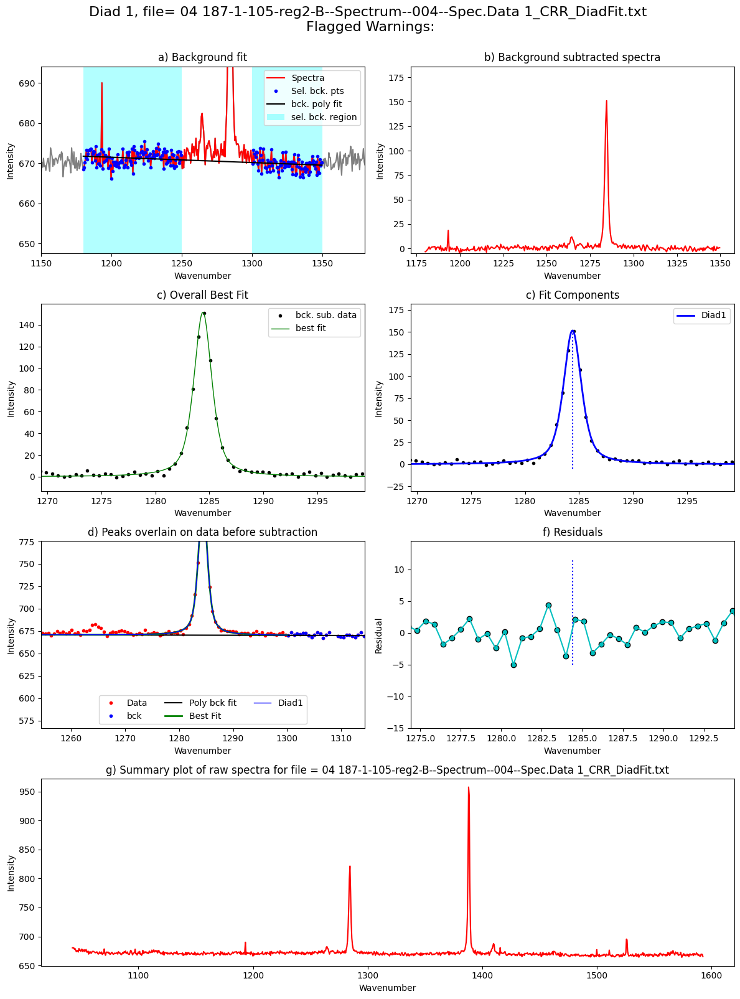

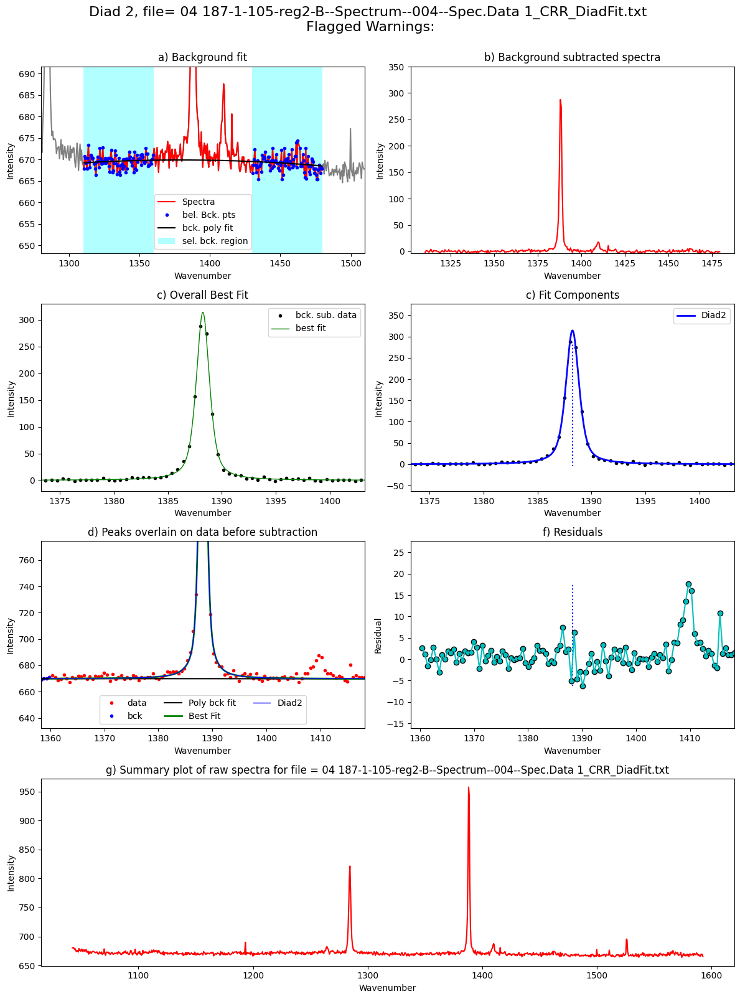

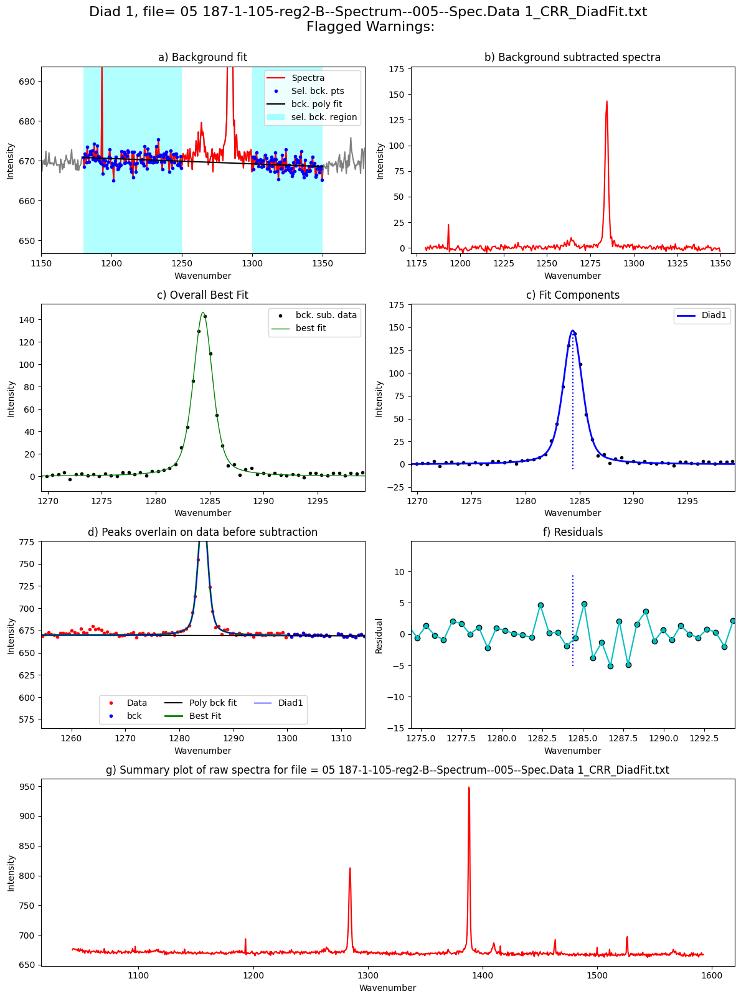

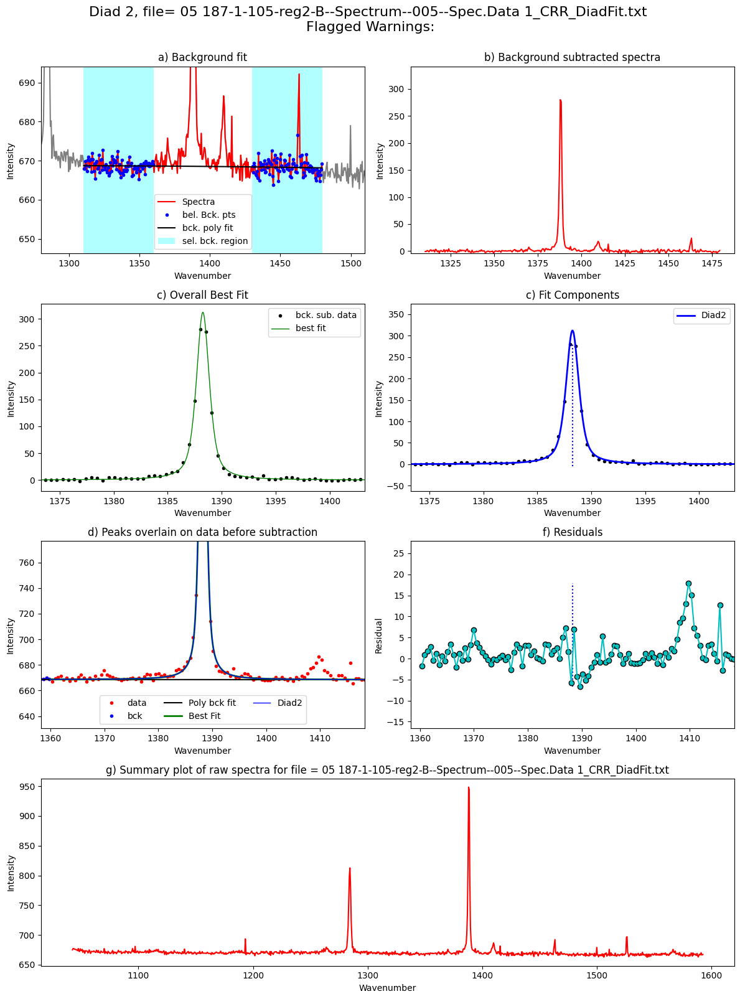

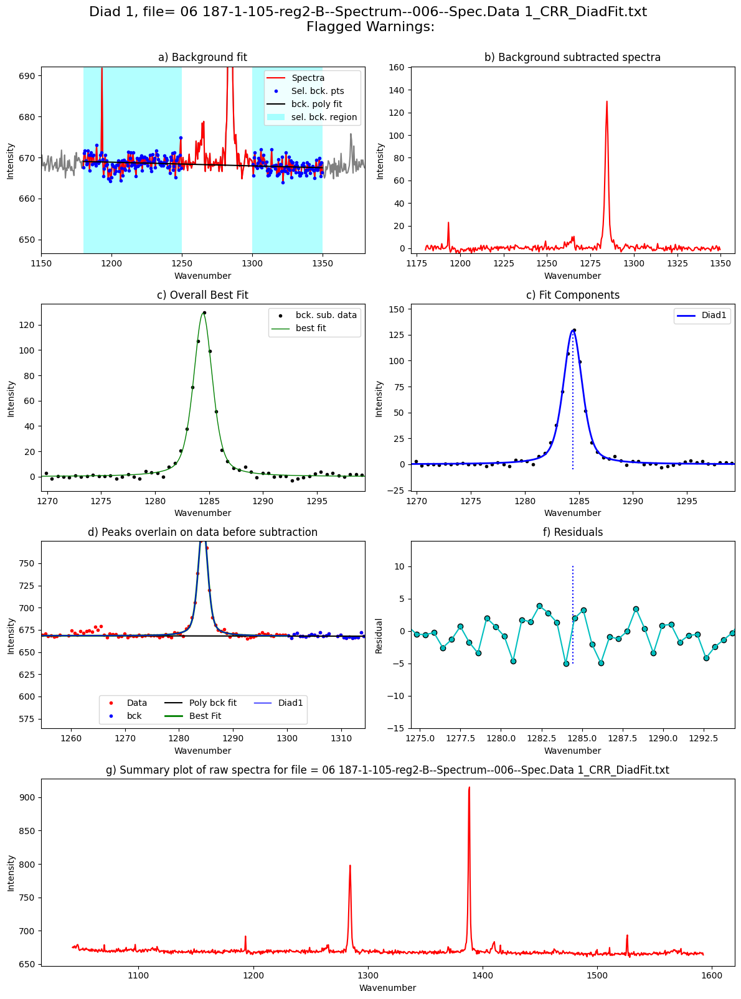

...

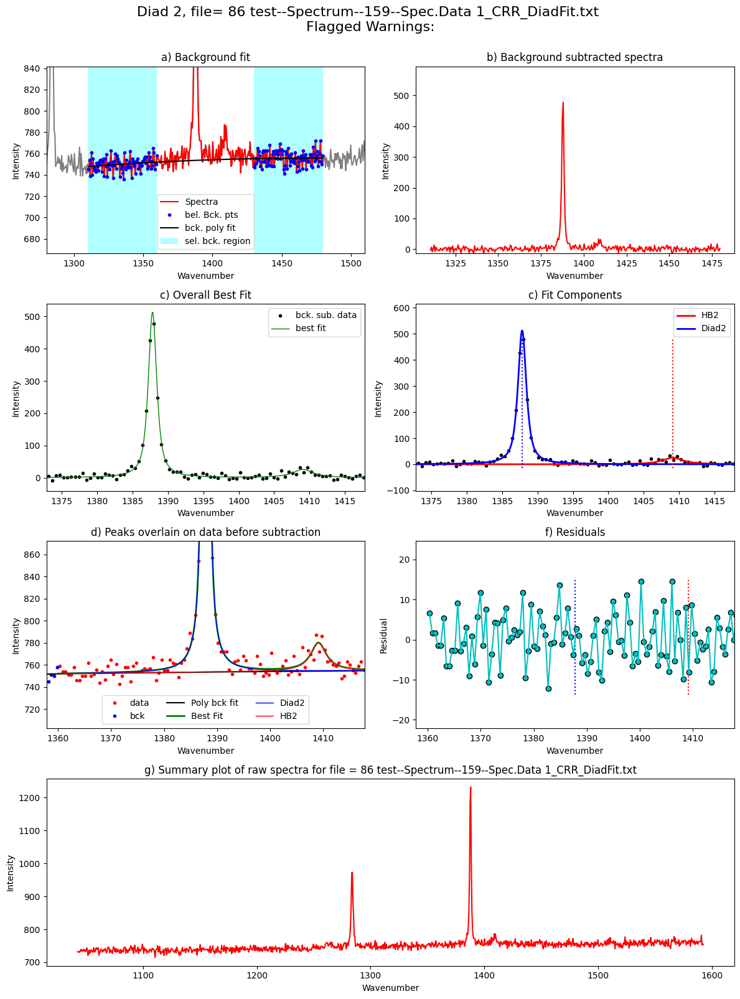

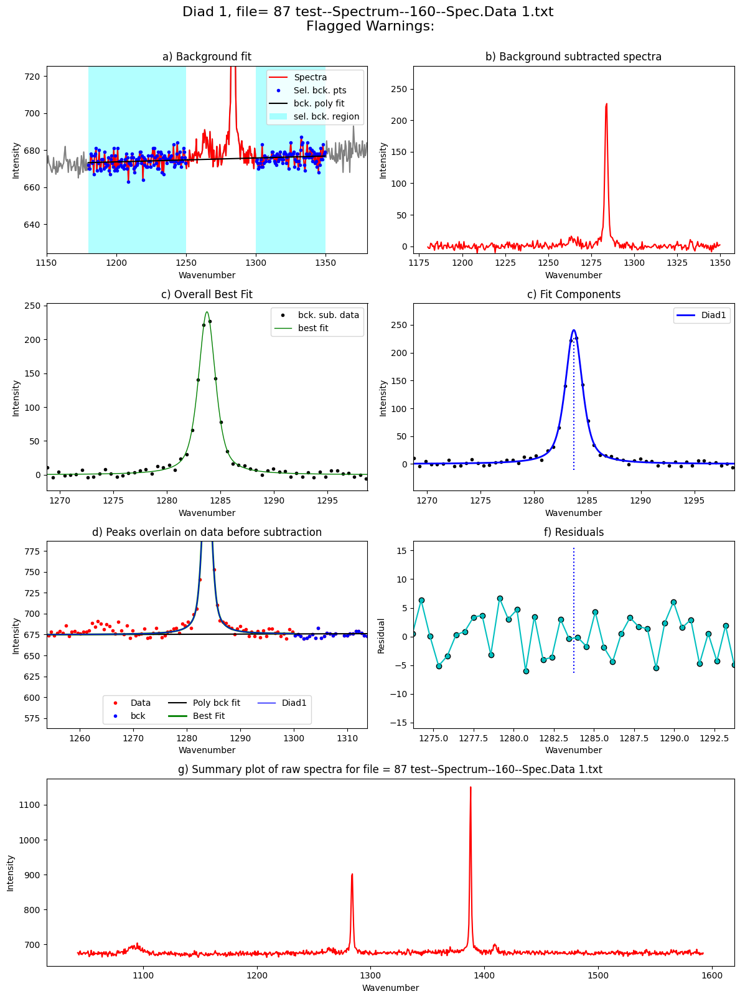

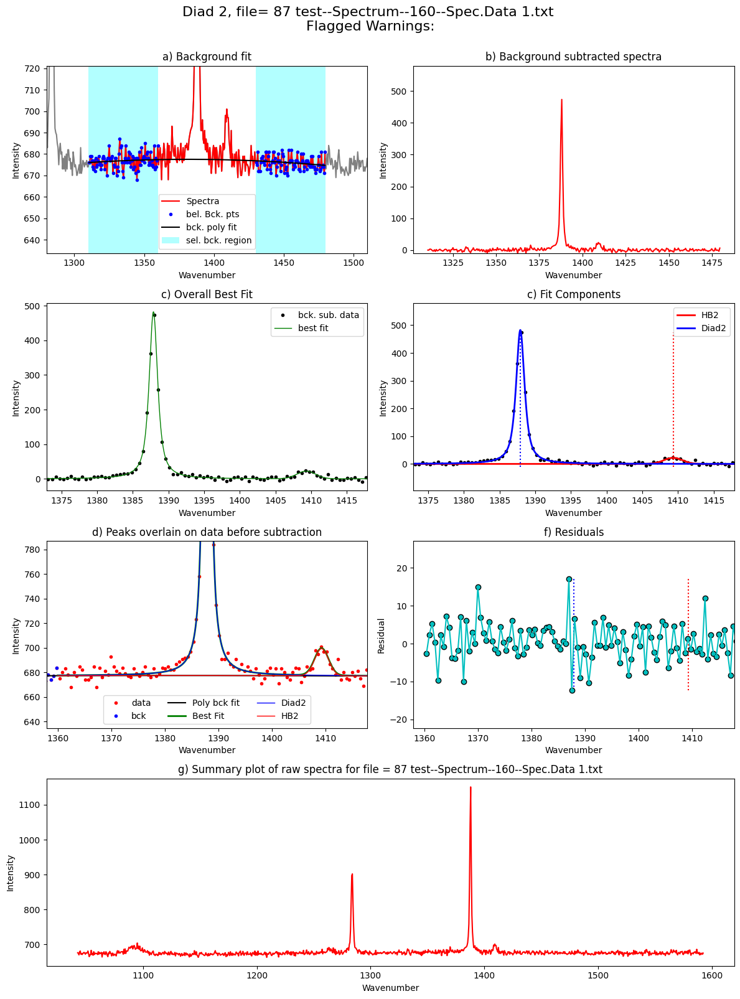

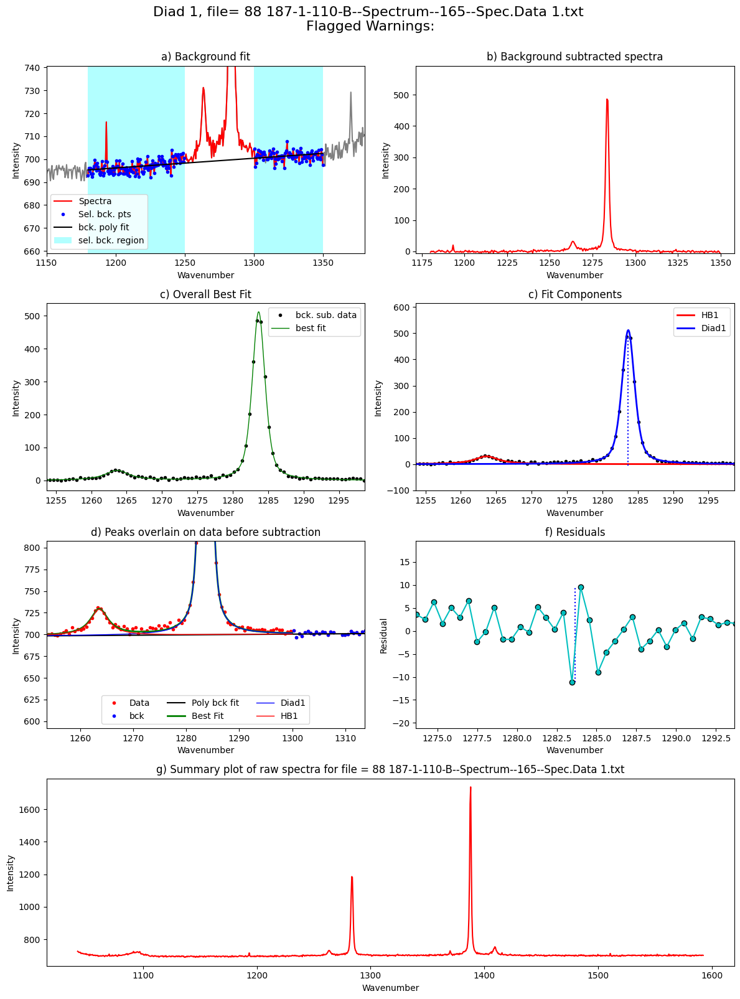

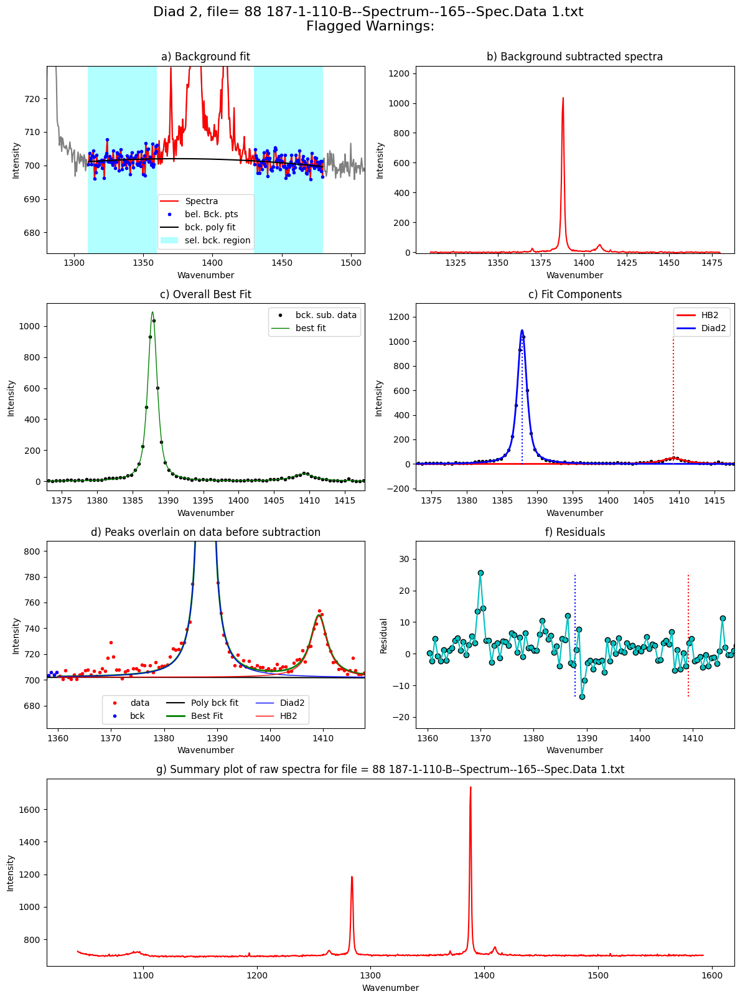

In [12]:
from tqdm import tqdm
plot_figure=True# If False, Means doesnt have to make figures, lot faster. 
close_figure=False # If True, wont show figures in notebook, but will still save them in a folder 
Diad_Files_i=Diad_Files
df_Merge = pd.DataFrame([])
for i in tqdm(range(0, len(Diad_Files))): #
    tqdm.write(f"Processing file: {Diad_Files[i]}")
    
    
    # For diad1, config file like you had in the previous. 
    # Only really used to exclude a range (say your spectra has a known spec)
    diad_id_config=pf.diad_id_config(exclude_range1=[1308, 1309])
    
    # Here, the prominence are taken from the fitting in the last notebook
    diad1_fit_config2.HB_prom=GroupN_df['HB1_abs_prom'].iloc[i]
    diad1_fit_config2.diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i]
    diad1_fit_config2.gauss_amp=2*GroupN_df['HB1_abs_prom'].iloc[i]

    Diad1_fit=pf.fit_diad_1_w_bck(config1=diad1_fit_config2,
    config2=diad_id_config, path=spectra_path, filename=GroupN_df['filename'].iloc[i],
    filetype=spectra_filetype, plot_figure=plot_figure, close_figure=close_figure,
    Diad_pos=GroupN_df['Diad1_pos'].iloc[i],
    HB_pos=GroupN_df['HB1_pos'].iloc[i])

    ## Same for diad2, just also has a C13 peak
    diad2_fit_config_init.HB_prom=GroupN_df['HB2_abs_prom'].iloc[i]
    diad2_fit_config_init.diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i]
    diad2_fit_config_init.gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i]
    diad2_fit_config_init.C13_prom=GroupN_df['C13_abs_prom'].iloc[i]
    
    
    Diad2_fit=pf.fit_diad_2_w_bck(config1=diad2_fit_config_init,
        config2=diad_id_config,
    path=spectra_path, filename=GroupN_df['filename'].iloc[i], 
    filetype=spectra_filetype,
    plot_figure=plot_figure, close_figure=close_figure,
    Diad_pos=GroupN_df['Diad2_pos'].iloc[i],
    HB_pos=GroupN_df['HB2_pos'].iloc[i], 
    C13_pos=GroupN_df['C13_pos'].iloc[i])
    
    # This combines the outputs into a single dataframe
    data=pf.combine_diad_outputs(filename=GroupN_df['filename'].iloc[i], prefix=prefix, 
    Diad1_fit=Diad1_fit, path=spectra_path,                  
    Diad2_fit=Diad2_fit)        
    
 

    df_Merge = pd.concat([df_Merge, data], axis=0).reset_index(drop=True)


In [13]:
# Save parameters to excel
combo=df_Merge

if batch=='Weak':
    combo.to_excel('Weak_Diads.xlsx', index=False)
if batch=='Medium':
    combo.to_excel('Medium_Diads.xlsx', index=False)
if batch=='Strong':
    combo.to_excel('Strong_Diads.xlsx', index=False)

In [14]:
combo

,filename,Splitting,Split_σ,Diad1_Combofit_Cent,Diad1_cent_err,Diad1_Combofit_Height,Diad1_Voigt_Cent,Diad1_Voigt_Area,Diad1_Voigt_Sigma,Diad1_Residual,...,Diad1_Asym50,Diad1_Asym70,Diad1_Yuan2017_sym_factor,Diad1_Remigi2021_BSF,Diad2_Asym50,Diad2_Asym70,Diad2_Yuan2017_sym_factor,Diad2_Remigi2021_BSF,Diad1_PDF_Model,Diad2_PDF_Model
0,187-1-105-reg2-B--Spectrum--004--Spec.Data 1_C...,103.842285,0.013779,1284.397846,0.012613,151.608468,1284.397846,411.388964,0.991986,2.190165,...,1.168831,1.206077,0.334956,0.013086,1.067442,1.087179,0.098406,0.004643,PseudoVoigtModel,PseudoVoigtModel
1,187-1-105-reg2-B--Spectrum--005--Spec.Data 1_C...,103.880851,0.014632,1284.379217,0.013123,146.594005,1284.379217,403.139006,1.053681,1.988558,...,1.114671,1.124224,0.241654,0.014375,1.088517,1.145133,0.126760,0.004587,PseudoVoigtModel,PseudoVoigtModel
2,187-1-105-reg2-B--Spectrum--006--Spec.Data 1_C...,103.847911,0.016040,1284.433888,0.014863,129.079304,1284.433888,349.582060,1.038116,1.935586,...,1.205725,1.225296,0.427132,0.016085,1.129032,1.186257,0.180898,0.005049,PseudoVoigtModel,PseudoVoigtModel
3,187-1-105-reg3-A--Spectrum--012--Spec.Data 1_C...,104.054245,0.013203,1283.987464,0.012756,126.853885,1283.987464,366.577331,1.070260,1.643804,...,1.086885,1.084223,0.185980,0.016874,1.027273,1.103161,0.040859,0.005573,PseudoVoigtModel,PseudoVoigtModel
4,187-1-105-reg3-A--Spectrum--016--Spec.Data 1,104.044949,0.014862,1284.004066,0.012756,133.621215,1284.004066,392.995786,1.108426,1.591925,...,1.083736,1.060573,0.185630,0.016591,1.025052,1.073846,0.040706,0.005799,PseudoVoigtModel,PseudoVoigtModel
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62,187-1-109-D--Spectrum--153--Spec.Data 1,104.057343,0.009873,1283.959799,0.009450,284.501874,1283.959799,850.215566,1.104259,3.371318,...,1.093248,1.040305,0.205939,0.007763,1.004329,1.003135,0.006679,0.002465,PseudoVoigtModel,PseudoVoigtModel
63,187-1-110-A--Spectrum--158--Spec.Data 1,104.244198,0.018823,1283.557852,0.017263,103.396668,1283.557852,313.875964,1.099264,1.706279,...,1.191275,1.071829,0.420524,0.021263,1.026804,1.034125,0.043302,0.007744,PseudoVoigtModel,PseudoVoigtModel
64,test--Spectrum--159--Spec.Data 1_CRR_DiadFit,104.065340,0.021930,1283.757193,0.020279,243.687880,1283.757193,654.727912,0.914111,5.477736,...,1.053045,1.192612,0.096978,0.007502,1.125908,1.115254,0.179836,0.002783,PseudoVoigtModel,PseudoVoigtModel
65,test--Spectrum--160--Spec.Data 1,104.145672,0.014540,1283.748862,0.013399,240.777761,1283.748862,628.821347,0.947094,3.862663,...,1.039427,1.040609,0.074681,0.007867,1.287958,1.256272,0.411679,0.002962,PseudoVoigtModel,PseudoVoigtModel


### This plays a sound when the notebook is done if you have a tendency to procrastinate

In [15]:
# !pip install winotify

from winotify import Notification, audio

toast= Notification(app_id="VSCode",title="Notebook completed",
                    msg="Step3b_Secondary_Peaks is done!",
                    duration="short")
toast.set_audio(audio.Mail,loop=False)
toast.show()